# SWOT KaRIn Sea Surface Height (SSH) Cloud Data Loading, Subsetting, and Visualization
> PO.DAAC, Jet Propulsion Laboratory, California Institution of Technology \
> Author: Ayush Nag

# Background

- This notebook allows you to visualize large amounts of SWOT data in an interactive dashboard
    - Connects to PO.DAAC SWOT collection
    - Reads data as `zarr` cloud-optimized data store
    - 173 GB in milliseconds
    
## User Workflow
1) Connect to SWOT collection (currently ~17k granules)
    - Very fast using `zarr`/`kerchunk` (500ms-1s)
2) Subset temporally or spatially 
    - Ex: lat/lon, time, or mean.
    - Can be done easily with `xarray`
    - Fast operations since `xarray` can slice with coordinates
3) Visualize
    - Analyze the data you selected
    - Interactive dashboard allows for panning around and zooming in to view full resolution swaths
    - Uses the familiar xarray interface; User can modify as needed and revisualize
    - Uses little system memory because of `xarray` + `zarr` + `dask` + `datashader` optimizations
4) Save
    - S3 bucket transfer
        - Fastest method of data transfer
        - Connect to your own workspace/code
    - PODAAC data subscriber (https://github.com/podaac/data-subscriber)
        - Explore data in this notebook; Then use `podaac-data-subscriber` CLI interface to filter and download netCDF's to local machine

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
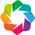

In [1]:
import s3fs
import glob
import dask
import ujson
import hvplot
import cartopy
import requests
import matplotlib
import hvplot.dask
import hvplot.xarray

import os
import numpy as np
import panel as pn
import xarray as xr
import holoviews as hv
import cartopy.crs as ccrs
import panel.widgets as pnw
import matplotlib.pyplot as plt

from tqdm.notebook import tqdm
from dask.distributed import Client

hv.extension('bokeh')
pn.param.ParamMethod.loading_indicator = True

## Start Dask cluster
- Data can be read from s3 in parallel and used by hvplot

In [2]:
dask.config.set(**{'array.slicing.split_large_chunks': False})
client = Client()
client

2023-08-24 03:48:29,938 - distributed.diskutils - INFO - Found stale lock file and directory '/tmp/dask-worker-space/worker-im6m0u3_', purging
2023-08-24 03:48:29,939 - distributed.diskutils - INFO - Found stale lock file and directory '/tmp/dask-worker-space/worker-xvx1anfl', purging
2023-08-24 03:48:29,939 - distributed.diskutils - INFO - Found stale lock file and directory '/tmp/dask-worker-space/worker-lg11h8_h', purging
2023-08-24 03:48:29,939 - distributed.diskutils - INFO - Found stale lock file and directory '/tmp/dask-worker-space/worker-wydtma76', purging


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 4,Total memory: 4.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:33003,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 4
Started: Just now,Total memory: 4.00 GiB
Comm: tcp://127.0.0.1:36793,Total threads: 1
Dashboard: http://127.0.0.1:37731/status,Memory: 1.00 GiB
Nanny: tcp://127.0.0.1:45467,


## Get PO.DAAC s3 credentials (authenticate via NASA Earthdata login) 

In [3]:
%%time
url = "https://archive.podaac.earthdata.nasa.gov/s3credentials"
creds = requests.get(url).json()
# TODO: print success message if HTTPS succeeded

CPU times: user 103 ms, sys: 7.06 ms, total: 110 ms
Wall time: 1.71 s


## Open collection using Kerchunk/Zarr
- This tutorial uses the PODAAC `SWOT_SIMULATED_L2_KARIN_SSH_GLORYS_SCIENCE_V1` collection (https://doi.org/10.5067/KARIN-2GLS1)
- Dataset explained
    - Dimensions
        - `cycle_number`: One cycle represents when SWOT records approximate global coverage (21 days of data)
        - `pass_number`: One swath represents one pass. Each granule/file in PO.DAAC is exactly one SWOT pass. The same pass number across cycles should match up spatially
        - `num_lines` and `num_pixels` represent the "length" and "width" of a satellite swath
        - `num_sides` represents the two swaths that the SWOT KaRIn instrument records. [Here](https://swot.cnes.fr/en/karin-0) is an excellent visual.
- Here is more info on how Kerchunk (link) and Zarr (link) work

In [4]:
%%time
data = xr.open_dataset(
    "reference://", engine="zarr", chunks={},
    backend_kwargs={
        "storage_options": 
        {"fo": "SWOT_SIMULATED_L2_KARIN_SSH_GLORYS_SCIENCE_V1_kerchunk_DEMO.json",
         "remote_protocol": "s3",
         "remote_options": {"anon": False, "key": creds['accessKeyId'], "secret": creds['secretAccessKey'], "token": creds["sessionToken"]}},
         "consolidated": False
    }
)
data.simulated_true_ssh_karin

CPU times: user 917 ms, sys: 82 ms, total: 999 ms
Wall time: 1.34 s


,Array,Chunk
Bytes,7.14 GiB,5.34 MiB
Shape,"(3, 456, 9866, 71)","(1, 1, 9866, 71)"
Count,1369 Tasks,1368 Chunks
Type,float64,numpy.ndarray
,Array,Chunk
Bytes,7.14 GiB,5.34 MiB
Shape,"(3, 456, 9866, 71)","(1, 1, 9866, 71)"
Count,1369 Tasks,1368 Chunks
Type,float64,numpy.ndarray
,Array,Chunk


In [9]:
# Note: this represents the amount of data needed in memory to load the entire dataset
# The actual files are smaller on disk (s3) because of netCDF compression
print(f'{data.nbytes / 1e9} GB')

385.573386456 GB


## Visualize with interactive dashboard

In [10]:
def dashboard(data: xr.Dataset, x="longitude", y="latitude", groupby=["cycle_num", "pass_num"]):
    """
    Creates dashboard that can visualize SWOT collection
    """
    # --- WIDGETS --- #
    # only keep the vars that are in swath format
    plotting_vars = [var for var in data.data_vars if set(data[var].dims) == {'cycle_num', 'pass_num', 'num_lines', 'num_pixels'}]
    var_select = pnw.Select(value='simulated_true_ssh_karin', options=plotting_vars, name="variable")
    # var_select = pnw.Select(value='simulated_true_ssh_karin', options=list(data.variables), name="variable")
    
    cmap = pnw.Select(value='jet', options=['jet', 'RdBu', 'viridis', 'plasma', 'inferno', 'magma', 'cividis'], name="colormap")
    agg_fn = pnw.Select(value='mean', options=['count','sum','min','max','mean','var','std'], name="aggregration function")
    normalization = pnw.Select(value='linear', options=['linear', 'eq_hist'], name="normalization")
    projection = pnw.Select(value='PlateCarree', options=['PlateCarree', 'SouthPolarStereo', 'NorthPolarStereo'], name="projection")
    # fixes certain projections to a zoomed in starting point (otherwise plot is zoomed out to show the whole swath)
    projection_xlim = {'PlateCarree': None, 'SouthPolarStereo': (-180, 180), 'NorthPolarStereo': (-180, 180)}
    projection_ylim = {'PlateCarree': None, 'SouthPolarStereo': (-30, -90), 'NorthPolarStereo': (30, 90)}
    coastlines=pnw.Checkbox(name="coastlines", value=True, width=65)
    colorbar=pnw.Checkbox(name="colorbar", value=True, width=60)
    grid=pnw.Checkbox(name="grid", value=False, width=60)
    # z_slider = pnw.IntSlider(name="z", start=0, end=data.z.size - 1, step=1, value=0, width=500)

    # def time_boxes(z):
        # return pn.Column(pnw.StaticText(name='start', value=str(data.time[z].values[0])), pnw.StaticText(name='end', value=str(data.time[z].values[data.num_lines.size - 1])))

    # --- INTERACTIVE PLOT --- #
    def data_plot(var, proj):
        return data[var].hvplot.points(
                x=x, xlabel=x,
                y=y, ylabel=y,
                groupby=groupby,
                # widgets={"z": z_slider},
                widget_location="bottom",
                aggregator=agg_fn, cnorm=normalization,
                cmap=cmap, colorbar=colorbar,
                coastline=coastlines, grid=grid,
                geo=True, projection=proj,
                # tools=['tap', 'wheel_zoom'],
                width=650, height=450,
                rasterize=True, project=True, dynspread=True,
                xlim=projection_xlim[proj], ylim=projection_ylim[proj],
                title=f"PODAAC SWOT L2 Dashboard ({str(var)})"
            )

    # bind functions to widgets (like update handlers)
    idata_plot = pn.bind(data_plot, var=var_select, proj=projection)
    # itime_boxes = pn.bind(time_boxes, z=z_slider)

    # --- DEFINE LAYOUT --- #
    # return pn.Row(pn.Column(idata_plot), pn.Column(var_select, agg_fn, normalization, cmap, projection, itime_boxes, pn.Row(coastlines, colorbar, grid)))
    return pn.Row(pn.Column(idata_plot), pn.Column(var_select, agg_fn, normalization, cmap, projection, pn.Row(coastlines, colorbar, grid)))

In [11]:
%time dashboard(data, groupby=['cycle_num', 'pass_num'])

CPU times: user 49.3 ms, sys: 3.73 ms, total: 53 ms
Wall time: 51.3 ms


Row
    [0] Column
        [0] ParamFunction(function)
    [1] Column
        [0] Select(name='variable', options=['ancillary_surface_classi...], value='simulated_true_ssh_karin'...)
        [1] Select(name='aggregration function', options=['count', 'sum', ...], value='mean')
        [2] Select(name='normalization', options=['linear', 'eq_hist'], value='linear')
        [3] Select(name='colormap', options=['jet', 'RdBu', ...], value='jet')
        [4] Select(name='projection', options=['PlateCarree', ...], value='PlateCarree')
        [5] Row
            [0] Checkbox(name='coastlines', value=True, width=65)
            [1] Checkbox(name='colorbar', value=True, width=60)
            [2] Checkbox(name='grid', width=60)

Note: if you get the error `DataError: XArrayInterface expects gridded data`. This means you need to refresh your PODAAC s3 credentials and reopen the dataset

## Example: Plot region within swath

In [21]:
%%time
small_ds = data.sel(cycle_num=4, pass_num=2)
# mask_lon = (small_ds.longitude >= -15) & (small_ds.longitude <= -10)
mask_lat = (small_ds.latitude >= -45) & (small_ds.latitude <= -40)

cropped_ds = small_ds.where(mask_lat, drop=True)
cropped_ds

CPU times: user 262 ms, sys: 6.67 ms, total: 268 ms
Wall time: 523 ms


<xarray.Dataset>
Dimensions:                                (num_lines: 304, num_pixels: 71,
                                            num_sides: 2)
Coordinates:
    cycle_num                              float64 4.0
    latitude                               (num_lines, num_pixels) float64 dask.array<chunksize=(304, 71), meta=np.ndarray>
    latitude_nadir                         (num_lines) float64 dask.array<chunksize=(304,), meta=np.ndarray>
    longitude                              (num_lines, num_pixels) float64 dask.array<chunksize=(304, 71), meta=np.ndarray>
    longitude_nadir                        (num_lines) float64 dask.array<chunksize=(304,), meta=np.ndarray>
    pass_num                               float64 2.0
Dimensions without coordinates: num_lines, num_pixels, num_sides
Data variables: (12/91)
    ancillary_surface_classification_flag  (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    correction_flag                        (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    cross_track_angle                      (num_lines, num_pixels) float64 dask.array<chunksize=(304, 71), meta=np.ndarray>
    cross_track_distance                   (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    dac                                    (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    depth_or_elevation                     (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    ...                                     ...
    wind_speed_karin                       (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    wind_speed_karin_2                     (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    wind_speed_model_u                     (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    wind_speed_model_v                     (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
    wind_speed_rad                         (num_lines, num_sides, num_pixels) float32 dask.array<chunksize=(304, 2, 71), meta=np.ndarray>
    x_factor                               (num_lines, num_pixels) float32 dask.array<chunksize=(304, 71), meta=np.ndarray>
Attributes: (12/32)
    Conventions:                CF-1.7
    contact:                    CNES aviso@altimetry.fr, JPL podaac@podaac.jp...
    cycle_number:               5
    ellipsoid_flattening:       0.003352810664781205
    ellipsoid_semi_major_axis:  6378137.0
    equator_longitude:          206.06188772087626
    ...                         ...
    right_last_longitude:       289.6585533138908
    source:                     Simulate product
    time_coverage_end:          2014-07-24T10:18:18.533147Z
    time_coverage_start:        2014-07-24T09:26:52.109265Z
    title:                      Level 2 Low Rate Sea Surface Height Data Prod...
    wavelength:                 0.008385803020979

CPU times: user 146 ms, sys: 14.6 ms, total: 161 ms
Wall time: 638 ms


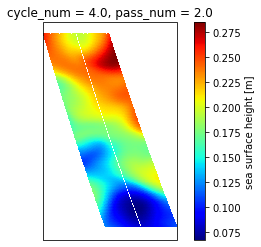

<Figure size 1512x1080 with 0 Axes>

In [22]:
%%time
ax = plt.axes(projection=ccrs.PlateCarree())
plt.figure(figsize=(21, 15))
cropped_ds.simulated_true_ssh_karin.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), x="longitude", y="latitude", cmap='jet', add_colorbar=True)

## Example: Plot 21-day cycle subset on the Southern Ocean
The coordinate `latitude_nadir` has dimensions `(z, num_lines)` since it only measures one pixel per line. Subsetting over this latitude is much faster and more memory efficient since there is less data to look over then KaRIn's latitude's `(z, num_lines, num_pixels)`

In [28]:
%%time
one_cycle = data.sel(cycle_num=3)
data_so = one_cycle.where((one_cycle.latitude_nadir <= -30), drop=True)
data_so

CPU times: user 3.8 s, sys: 157 ms, total: 3.95 s
Wall time: 20 s


<xarray.Dataset>
Dimensions:                                (pass_num: 456, num_lines: 6491,
                                            num_pixels: 71, num_sides: 2)
Coordinates:
    cycle_num                              float64 3.0
    latitude                               (pass_num, num_lines, num_pixels) float64 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    latitude_nadir                         (pass_num, num_lines) float64 dask.array<chunksize=(1, 6491), meta=np.ndarray>
    longitude                              (pass_num, num_lines, num_pixels) float64 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    longitude_nadir                        (pass_num, num_lines) float64 dask.array<chunksize=(1, 6491), meta=np.ndarray>
  * pass_num                               (pass_num) float64 1.0 2.0 ... 583.0
Dimensions without coordinates: num_lines, num_pixels, num_sides
Data variables: (12/91)
    ancillary_surface_classification_flag  (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    correction_flag                        (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    cross_track_angle                      (pass_num, num_lines) float64 dask.array<chunksize=(1, 6491), meta=np.ndarray>
    cross_track_distance                   (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    dac                                    (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    depth_or_elevation                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    ...                                     ...
    wind_speed_karin                       (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    wind_speed_karin_2                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    wind_speed_model_u                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    wind_speed_model_v                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
    wind_speed_rad                         (pass_num, num_lines, num_sides) float32 dask.array<chunksize=(1, 6491, 2), meta=np.ndarray>
    x_factor                               (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 6491, 71), meta=np.ndarray>
Attributes: (12/32)
    Conventions:                CF-1.7
    contact:                    CNES aviso@altimetry.fr, JPL podaac@podaac.jp...
    cycle_number:               5
    ellipsoid_flattening:       0.003352810664781205
    ellipsoid_semi_major_axis:  6378137.0
    equator_longitude:          206.06188772087626
    ...                         ...
    right_last_longitude:       289.6585533138908
    source:                     Simulate product
    time_coverage_end:          2014-07-24T10:18:18.533147Z
    time_coverage_start:        2014-07-24T09:26:52.109265Z
    title:                      Level 2 Low Rate Sea Surface Height Data Prod...
    wavelength:                 0.008385803020979

## Using `.coarsen()`
- Xarray has built in functionality to coarsen the data to avoid overplotting and fit the data into memory

In [29]:
%%time
data_so = data_so.coarsen({'num_pixels': 3, 'num_lines': 4}, boundary='trim').mean()
data_so

CPU times: user 1.22 s, sys: 53.4 ms, total: 1.28 s
Wall time: 1.42 s


<xarray.Dataset>
Dimensions:                                (pass_num: 456, num_lines: 1622,
                                            num_pixels: 23, num_sides: 2)
Coordinates:
    cycle_num                              float64 3.0
    latitude                               (pass_num, num_lines, num_pixels) float64 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    latitude_nadir                         (pass_num, num_lines) float64 dask.array<chunksize=(1, 1622), meta=np.ndarray>
    longitude                              (pass_num, num_lines, num_pixels) float64 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    longitude_nadir                        (pass_num, num_lines) float64 dask.array<chunksize=(1, 1622), meta=np.ndarray>
  * pass_num                               (pass_num) float64 1.0 2.0 ... 583.0
Dimensions without coordinates: num_lines, num_pixels, num_sides
Data variables: (12/91)
    ancillary_surface_classification_flag  (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    correction_flag                        (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    cross_track_angle                      (pass_num, num_lines) float64 dask.array<chunksize=(1, 1622), meta=np.ndarray>
    cross_track_distance                   (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    dac                                    (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    depth_or_elevation                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    ...                                     ...
    wind_speed_karin                       (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    wind_speed_karin_2                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    wind_speed_model_u                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    wind_speed_model_v                     (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
    wind_speed_rad                         (pass_num, num_lines, num_sides) float32 dask.array<chunksize=(1, 1622, 2), meta=np.ndarray>
    x_factor                               (pass_num, num_lines, num_pixels) float32 dask.array<chunksize=(1, 1622, 23), meta=np.ndarray>
Attributes: (12/32)
    Conventions:                CF-1.7
    contact:                    CNES aviso@altimetry.fr, JPL podaac@podaac.jp...
    cycle_number:               5
    ellipsoid_flattening:       0.003352810664781205
    ellipsoid_semi_major_axis:  6378137.0
    equator_longitude:          206.06188772087626
    ...                         ...
    right_last_longitude:       289.6585533138908
    source:                     Simulate product
    time_coverage_end:          2014-07-24T10:18:18.533147Z
    time_coverage_start:        2014-07-24T09:26:52.109265Z
    title:                      Level 2 Low Rate Sea Surface Height Data Prod...
    wavelength:                 0.008385803020979

## Example: Plotting granules

  0%|          | 0/228 [00:00<?, ?it/s]

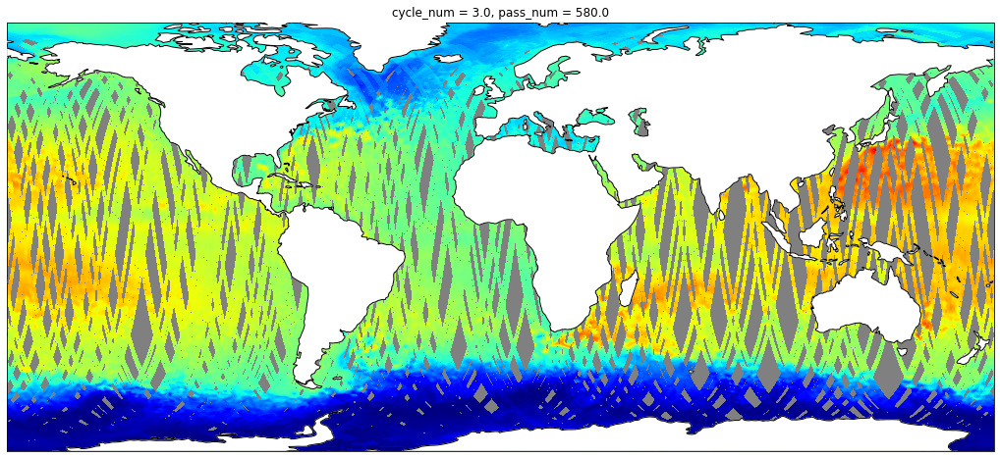

In [4]:
map_proj = ccrs.PlateCarree()
fig = plt.figure(figsize=[18, 12])  # inches
# fig.suptitle('SWOT L2 Sea Surface Height (m)', fontsize=16)
ax = plt.subplot(projection=map_proj)
ax.set_facecolor("gray")
# ax.set_extent([-180, 180, -90, -39.4], ccrs.PlateCarree())
# fig.subplots_adjust(bottom=0.05, top=0.95, left=0.04, right=0.95, wspace=0.02)
ax.add_feature(cartopy.feature.LAND, zorder=10, facecolor='w')
ax.add_feature(cartopy.feature.COASTLINE, zorder=10)
# ax.gridlines(xlocs=[-130, -60, 20, 90, 160], draw_labels=True)

for pass_num in tqdm(data.pass_num.values[::2]):
    data.isel(cycle_num=0).sel(pass_num=pass_num).simulated_true_ssh_karin.plot.pcolormesh(x='longitude', y='latitude', ax=ax, cmap='jet', transform=ccrs.PlateCarree(), add_colorbar=False)

## Export to S3 bucket or local download

In [ ]:
data.to_netcdf("SWOT_spatial_subset.nc", mode='w')

In [ ]:
data.to_zarr("SWOT_spatial_subset.zarr", chunks={}, mode='w', consolidated=True)

In [ ]:
s3_sandbox = s3fs.S3FileSystem(key="", secret="")
store = s3fs.S3Map(root="s3://.../swot_21_day.zarr", s3=s3_sandbox)
data.to_zarr(store, chunks={}, mode='w', consolidated=True)

# Appendix/Extras

## Open with test Zarr

In [17]:
f = open("s3-creds.json", "r")
creds = ujson.load(f)
f.close()
s3_sandbox = s3fs.S3FileSystem(key=creds["AWS_ACCESS_KEY_ID"], secret=creds["AWS_SECRET_ACCESS_KEY"])
store = s3fs.S3Map(root="s3://.../swot_zarr_21_day_mod.zarr", s3=s3_sandbox)
%time data = xr.open_zarr(store, chunks={}, consolidated=True)
data

CPU times: user 275 ms, sys: 28.1 ms, total: 303 ms
Wall time: 739 ms


<xarray.Dataset>
Dimensions:                                (z: 616, num_lines: 9864,
                                            num_pixels: 71, num_sides: 2)
Coordinates:
    latitude                               (z, num_lines, num_pixels) float64 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    latitude_nadir                         (z, num_lines) float64 dask.array<chunksize=(1, 9864), meta=np.ndarray>
    longitude                              (z, num_lines, num_pixels) float64 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    longitude_nadir                        (z, num_lines) float64 dask.array<chunksize=(1, 9864), meta=np.ndarray>
Dimensions without coordinates: z, num_lines, num_pixels, num_sides
Data variables: (12/93)
    ancillary_surface_classification_flag  (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    correction_flag                        (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    cross_track_angle                      (z, num_lines) float64 dask.array<chunksize=(1, 9864), meta=np.ndarray>
    cross_track_distance                   (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    cycle_number                           (z) int16 dask.array<chunksize=(616,), meta=np.ndarray>
    dac                                    (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    ...                                     ...
    wind_speed_karin                       (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    wind_speed_karin_2                     (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    wind_speed_model_u                     (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    wind_speed_model_v                     (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
    wind_speed_rad                         (z, num_lines, num_sides) float32 dask.array<chunksize=(1, 9864, 2), meta=np.ndarray>
    x_factor                               (z, num_lines, num_pixels) float32 dask.array<chunksize=(1, 9864, 71), meta=np.ndarray>
Attributes: (12/32)
    Conventions:                CF-1.7
    contact:                    CNES aviso@altimetry.fr, JPL podaac@podaac.jp...
    cycle_number:               4
    ellipsoid_flattening:       0.003352810664781205
    ellipsoid_semi_major_axis:  6378137.0
    equator_longitude:          225.18862751249918
    ...                         ...
    right_last_longitude:       308.65044766455395
    source:                     Simulate product
    time_coverage_end:          2014-07-01T00:40:37.846974Z
    time_coverage_start:        2014-06-30T23:49:11.421067Z
    title:                      Level 2 Low Rate Sea Surface Height Data Prod...
    wavelength:                 0.008385803020979

## Create shapefile for swath

CPU times: user 140 ms, sys: 11.6 ms, total: 151 ms
Wall time: 643 ms


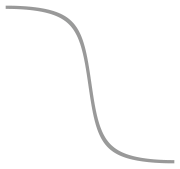

In [18]:
%%time
g = 0
lon = np.concatenate([data['longitude'][g, :, 0], data['longitude'][g, :, 70][::-1]])
lat = np.concatenate([data['latitude'][g, :, 0], data['latitude'][g, :, 70][::-1]])
Polygon(zip(lon, lat))

Edge case (to be fixed)
- Needs to handle case where longitude jumps from 0 to 360. The swath is not numerically continous (longitude). Probably create MultiPolygon at split point
- Split point is when values go from (+) -> (-) or (-) to (+) ```split_points = np.where(lon_left[1:] <= lon_left[:-1])[0]```

CPU times: user 146 ms, sys: 5.43 ms, total: 152 ms
Wall time: 638 ms


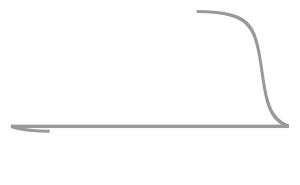

In [17]:
%%time
from shapely.geometry import Polygon
g = 3
lon = np.concatenate([data['longitude'][g, :, 0], data['longitude'][g, :, 70][::-1]])
lat = np.concatenate([data['latitude'][g, :, 0], data['latitude'][g, :, 70][::-1]])
Polygon(zip(lon, lat))

### Interactive plot of swath shapefiles

In [ ]:
%%time
z = 0
granules = 5
swaths, passes = [], []
for i in tqdm(range(granules)):
    lon = np.concatenate([data['longitude'][i, :, 0], data['longitude'][i, :, 70][::-1]])
    lat = np.concatenate([data['latitude'][i, :, 0], data['latitude'][i, :, 70][::-1]])
    swaths.append(Polygon(zip(lon, lat)))
    passes.append(i)
data_df = pd.DataFrame({"indexer": np.arange(granules), "pass": passes})
swaths_gdf = gpd.GeoDataFrame(data_df, geometry=swaths)
swaths_gdf.hvplot.polygons(
    coastline=True,
    geo=True,
    alpha=0.3,
    project=True,
    width=650,
    height=450,
)